In [12]:
from src.common.constants import Constants as consts

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from src.preprocessing.embedding_cluster_mapper import EmbeddingClusterMapper

k_list = [2, 3, 5, 10, 20]
mapper = EmbeddingClusterMapper(K_list=k_list, random_state=42)
embeddings = np.random.rand(1000, 128)
metadata = pd.DataFrame({
    'file_path': [f'audio{i}.wav' for i in range(1000)],
    'label': np.random.choice([0, 1], size=1000)
})

slihouette_scores, inertia_values = mapper.get_info_for_each_cluster(embeddings)

In [3]:
print(inertia_values)

{2: 6782.376028686156, 3: 6705.5337680436405, 5: 6605.023071709454, 10: 6417.701402716372, 20: 6190.507844453943}


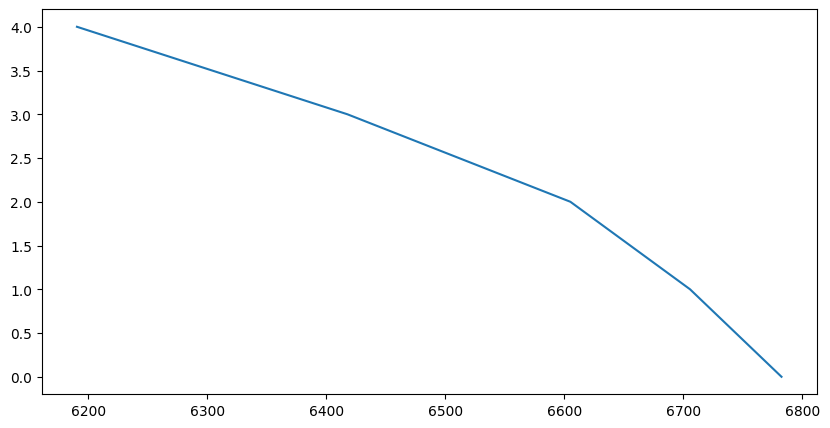

In [4]:
plt.figure(figsize=(10, 5))
plt.plot(inertia_values.values(), np.arange(0, len(inertia_values), 1))

In [3]:
from src.preprocessing.feature_loader import FeatureLoader
from src.preprocessing.embedding_cluster_mapper import EmbeddingClusterMapper

feature_loader = FeatureLoader(file_name="feature_extracted")
file_path = feature_loader.data_dir / "feature_extracted.csv"
metadata = feature_loader.load_metadata_file(file_path)
print(metadata.shape)

(1125881, 7)


In [4]:
train_meta, train_emb = feature_loader.transform(split_name="train")
print(train_meta.shape, train_emb.shape)

(788680, 7) (788680, 768)


In [5]:
train_meta = train_meta.reset_index(drop=True)
sampled_train_meta = feature_loader.sample_fraction(metadata=train_meta, fraction=0.05)
sampled_train_emb = train_emb[sampled_train_meta.index]
print(sampled_train_meta.shape, sampled_train_emb.shape)

(39434, 7) (39434, 768)


In [83]:
print(sampled_train_meta[sampled_train_meta['speaker_id'] == 10226].count())

speaker_labels = (sampled_train_meta['speaker_id'] == 10226).astype(int).to_numpy()
print(speaker_labels)

duration          678
starting_point    678
config            678
split             678
record_id         678
speaker_id        678
target            678
dtype: int64
[0 0 1 ... 0 0 0]


In [ ]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

pca = PCA(n_components=10, random_state=42)
reduced_embeddings = pca.fit_transform(sampled_train_emb)
print(reduced_embeddings.shape)

(39434, 10)


In [4]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer("l2")
norm_emb = normalizer.fit_transform(sampled_train_emb)
print(norm_emb.shape)

(39434, 768)


In [6]:
from umap import UMAP

umap_model = UMAP(
    n_components=2,      # 2 dla wizualizacji, 10–20 dla dalszego klastrowania
    n_neighbors=30,      # większe = gładsza struktura
    min_dist=0.2,
    metric="cosine",  # po L2 odpowiada cosinusowi
    random_state=37,
)

X_umap_2d2 = umap_model.fit_transform(sampled_train_emb)

/Users/mikolajkarapka/Projects/audio-deepfake-detection-uwr/.venv/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [7]:
def plot_umap_clusters(X_umap_2d, clusters, alpha=0.7, cmap='tab20', size=1):
    print(np.sum(clusters == -1))  # Number of noise points
    print(np.unique(clusters, return_counts=True))
    plt.figure(figsize=(10, 8))
    plt.scatter(X_umap_2d[:, 0], X_umap_2d[:, 1], s=size, alpha=alpha, c=clusters, cmap=cmap)
    plt.xlabel("UMAP 1")
    plt.ylabel("UMAP 2")
    plt.title("UMAP embeddings")
    plt.colorbar(label='Cluster Label')
    plt.legend()
    plt.show()

In [13]:
umap_model = UMAP(
    n_components=20,      # 2 dla wizualizacji, 10–20 dla dalszego klastrowania
    n_neighbors=30,      # większe = gładsza struktura
    min_dist=0.24,
    metric="cosine",  # po L2 odpowiada cosinusowi
    random_state=37,
)

X_umap_10d3 = umap_model.fit_transform(sampled_train_emb)

/Users/mikolajkarapka/Projects/audio-deepfake-detection-uwr/.venv/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [8]:
umap_model = UMAP(
    n_components=20,      # 2 dla wizualizacji, 10–20 dla dalszego klastrowania
    n_neighbors=30,      # większe = gładsza struktura
    min_dist=0.1,
    metric="cosine",  # po L2 odpowiada cosinusowi
    random_state=42,
)

X_umap_20d = umap_model.fit_transform(sampled_train_emb)

/Users/mikolajkarapka/Projects/audio-deepfake-detection-uwr/.venv/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [27]:
umap_model = UMAP(
    n_components=20,      # 2 dla wizualizacji, 10–20 dla dalszego klastrowania
    n_neighbors=70,      # większe = gładsza struktura
    min_dist=0.15,
    metric="cosine",  # po L2 odpowiada cosinusowi
    random_state=37,
)

X_umap_20d1 = umap_model.fit_transform(sampled_train_emb)

/Users/mikolajkarapka/Projects/audio-deepfake-detection-uwr/.venv/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [26]:
import numpy as np
from hdbscan import HDBSCAN
import matplotlib.pyplot as plt

metrics = ["euclidean"]
min_cluster_sizes = np.arange(300, 700, 25)
min_samples_list = np.arange(10, 50, 5)
print(len(metrics), len(min_cluster_sizes), len(min_samples_list), len(metrics) * len(min_cluster_sizes) * len(min_samples_list))

def test_hdbscan_params(X_umap, X_umap_2d):
    results = []
    for metric in metrics:
        for min_cluster_size in min_cluster_sizes:
            for min_samples in min_samples_list:
                hdbscan = HDBSCAN(
                    min_cluster_size=min_cluster_size,
                    min_samples=min_samples,
                    metric=metric,
                    cluster_selection_method="leaf",
                )
                hdbscan.fit(X_umap)
                clusters = hdbscan.labels_
                print(f"Metric: {metric}, Min Cluster Size: {min_cluster_size}, Min Samples: {min_samples}")
                results.append((metric, min_cluster_size, min_samples, clusters))
    results = sorted(results, key=lambda x: (x[1], x[2]))
    return results

def plot_all_results(results, X_umap_2d):
    cols_size = 3
    rows_size = int(np.ceil(len(results) / cols_size))
    plt.figure(figsize=(5 * cols_size, 5 * rows_size))
    for i, (metric, min_cluster_size, min_samples, clusters) in enumerate(results):
        plt.subplot(rows_size, cols_size, i+1)
        plt.title(f"Metric: {metric}\nMin Cluster Size: {min_cluster_size}, Min Samples: {min_samples}")
        plt.scatter(X_umap_2d[:, 0], X_umap_2d[:, 1], s=1, alpha=0.7, c=clusters, cmap='tab10')
        plt.xlabel("UMAP 1")
        plt.ylabel("UMAP 2")
    plt.tight_layout()
    plt.show()

1 16 8 128


20143
(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19]), array([20143,  2366,  1038,   732,   934,   916,  1525,  1002,   746,
         468,   972,   735,   923,   443,   608,   908,   416,   753,
        1074,  2280,   452]))


/var/folders/1d/mv_j9c7964b105nch0pj7kgh0000gn/T/ipykernel_47602/318230882.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


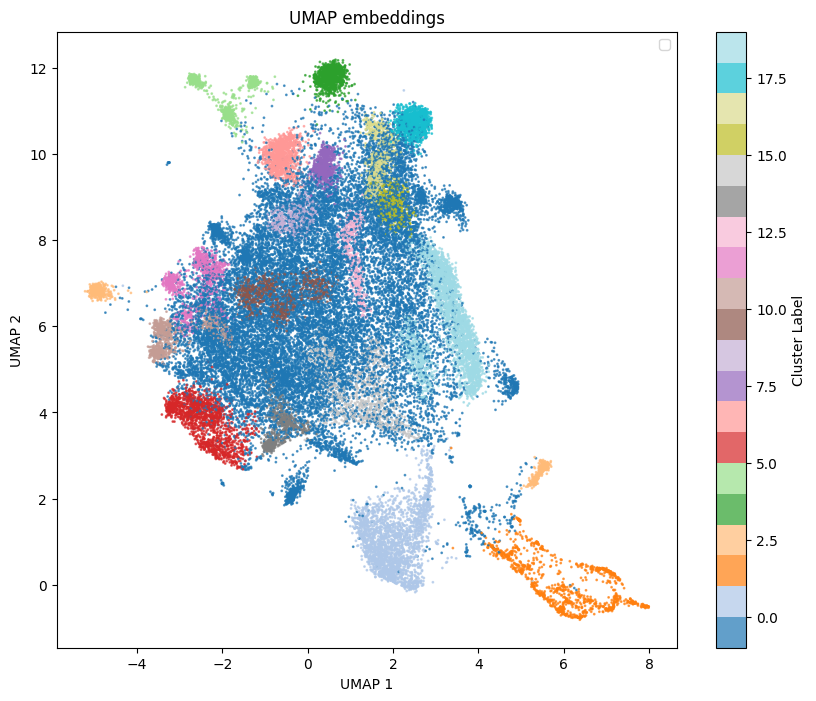

In [216]:
from hdbscan import HDBSCAN

hdbscan_clf = HDBSCAN(
    min_cluster_size=400,
    min_samples=45,
    metric="euclidean",
    cluster_selection_method="leaf",
)
hdbscan_clf.fit(X_umap_20d1)
clusters = hdbscan_clf.labels_
plot_umap_clusters(X_umap_2d2, clusters, alpha=0.7, cmap='tab20', size=1)

14934
(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27]), array([14934,   380,   364,  1239,   957,   343,   576,   368,   335,
         448,   612,  2323,   615,  1086,   361,  1208,  1410,   964,
         797,   490,  1659,   336,   548,  2718,  1143,   782,   502,
        1041,   895]))


/var/folders/1d/mv_j9c7964b105nch0pj7kgh0000gn/T/ipykernel_47602/318230882.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


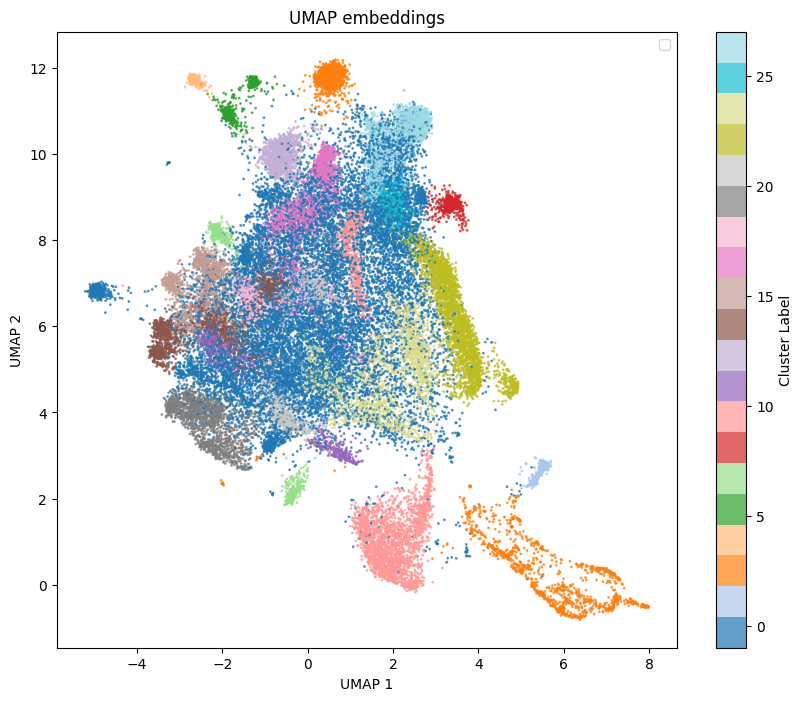

In [246]:
from hdbscan import HDBSCAN

hdbscan_clf = HDBSCAN(
    min_cluster_size=335,
    min_samples=2,
    metric="euclidean",
    cluster_selection_method="eom",
)
hdbscan_clf.fit(X_umap_20d)
clusters = hdbscan_clf.labels_


plot_umap_clusters(X_umap_2d2, clusters, alpha=0.7, cmap='tab20', size=1)

[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0 -1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0 -1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0

/var/folders/1d/mv_j9c7964b105nch0pj7kgh0000gn/T/ipykernel_47602/318230882.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


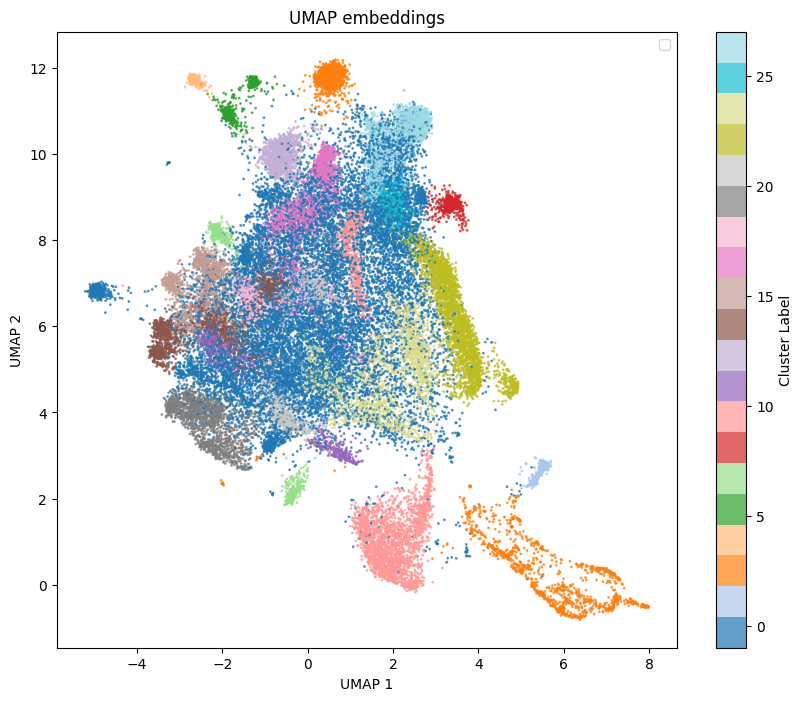

In [247]:

from hdbscan import HDBSCAN

hdbscan_clf = HDBSCAN(
    min_cluster_size=335,
    min_samples=2,
    metric="euclidean",
    cluster_selection_method="eom",
)
hdbscan_clf.fit(X_umap_20d)
clusters = hdbscan_clf.labels_
print(clusters[X_umap_2d2[:,0] < -4])
plot_umap_clusters(X_umap_2d2, clusters, alpha=0.7, cmap='tab20', size=1)

13886
(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
       33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49,
       50, 51, 52]), array([13886,   380,   959,  1236,   364,   343,   237,   282,   369,
         328,   454,   275,   270,   189,   612,   239,   332,  2319,
         597,   305,   131,   240,   303,   379,  1038,   186,   290,
         826,   320,   186,   614,   299,   289,   476,   337,   590,
         200,   602,   341,   177,   282,   192,   513,   231,   290,
        1103,   447,   793,   184,   685,   210,  2096,   230,   378]))


/var/folders/1d/mv_j9c7964b105nch0pj7kgh0000gn/T/ipykernel_47602/318230882.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


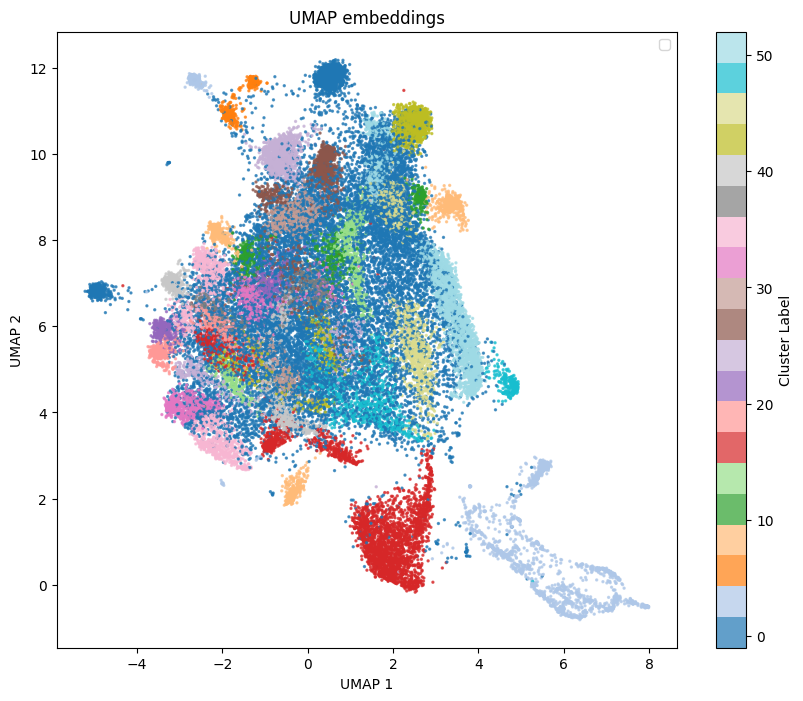

In [135]:
from hdbscan import HDBSCAN

hdbscan_clf = HDBSCAN(
    min_cluster_size=120,
    min_samples=3,
    metric="euclidean",
    cluster_selection_method="eom",
)
hdbscan_clf.fit(X_umap_20d)
clusters = hdbscan_clf.labels_
plot_umap_clusters(X_umap_2d2, clusters, alpha=0.7, cmap='tab20', size=2)

16554
(array([-1]), array([16554]))


/var/folders/1d/mv_j9c7964b105nch0pj7kgh0000gn/T/ipykernel_47602/318230882.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


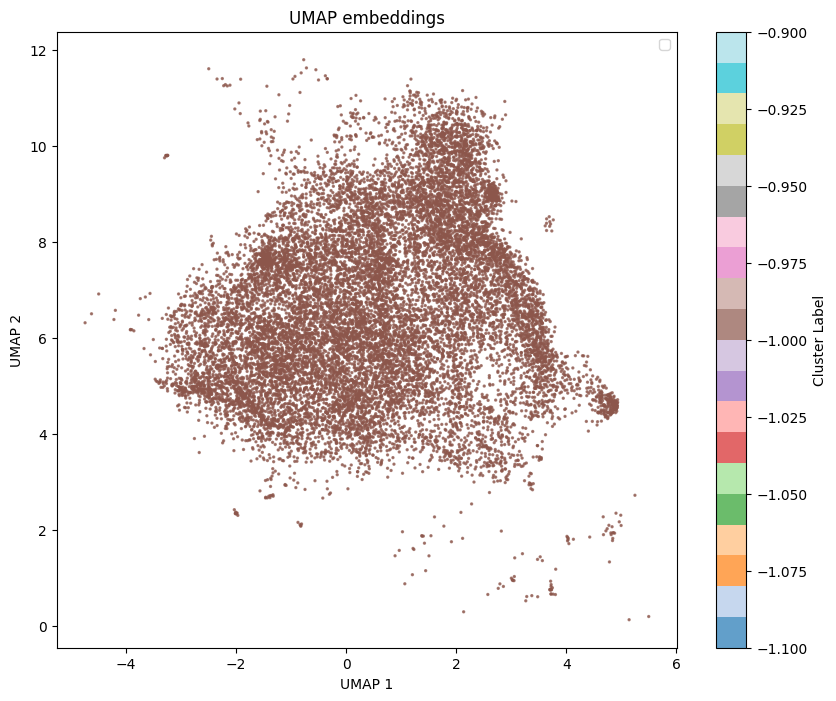

In [248]:
from hdbscan import HDBSCAN

hdbscan_clf = HDBSCAN(
    min_cluster_size=300,
    min_samples=50,
    metric="euclidean",
    cluster_selection_method="leaf",
)
hdbscan_clf.fit(X_umap_20d)
clusters = hdbscan_clf.labels_
plot_umap_clusters(X_umap_2d2[clusters==-1], clusters[clusters==-1], alpha=0.7, cmap='tab20', size=2)

18961
(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24]), array([18961,   927,  1112,   379,   370,   361,   449,   304,   928,
        2296,   550,  1209,  1824,   970,   793,   328,   714,   384,
         488,   483,   420,   433,   378,   989,  2190,  1194]))


/var/folders/1d/mv_j9c7964b105nch0pj7kgh0000gn/T/ipykernel_47602/318230882.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


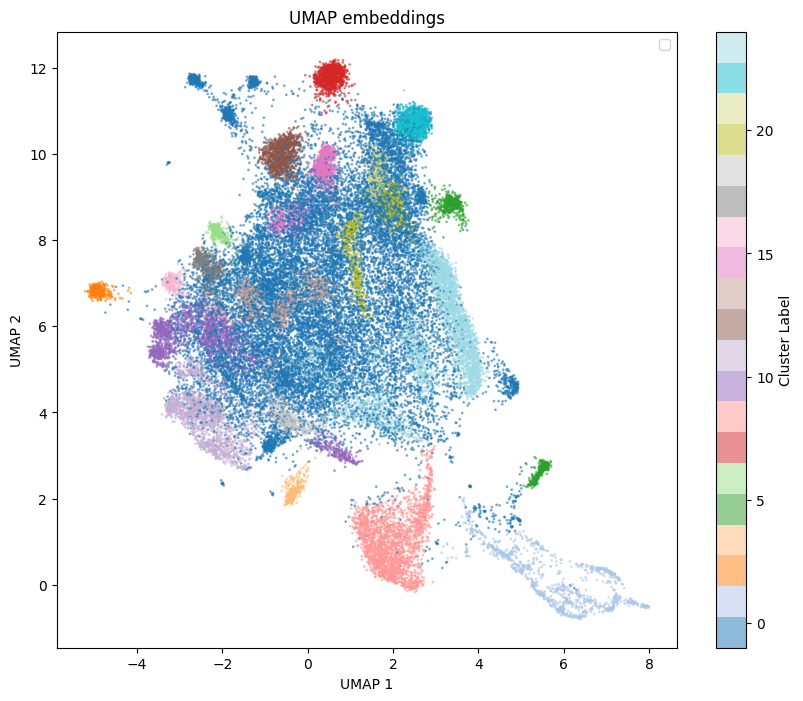

In [236]:
from hdbscan import HDBSCAN

hdbscan_clf = HDBSCAN(
    min_cluster_size=300,
    min_samples=15,
    metric="euclidean",
    cluster_selection_method="eom",
)
hdbscan_clf.fit(X_umap_10d3)
clusters = hdbscan_clf.labels_
plot_umap_clusters(X_umap_2d2, clusters, alpha=0.5, cmap='tab20', size=1)

17456
(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
       33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49,
       50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62]), array([17456,   381,   247,   337,   287,   362,  1112,   371,    95,
         205,   932,   418,   164,   308,   456,   239,   387,   995,
         122,   207,  2305,   184,   267,    91,   382,   318,   219,
          83,   178,    57,   271,   234,   141,    65,   337,   769,
         177,   204,   226,   284,   285,   228,   160,   944,   371,
          56,   223,    60,   129,   273,   295,    45,   114,   245,
        2242,   153,   183,   417,    51,   273,    49,   361,    54,
         350]))


/var/folders/1d/mv_j9c7964b105nch0pj7kgh0000gn/T/ipykernel_47602/318230882.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


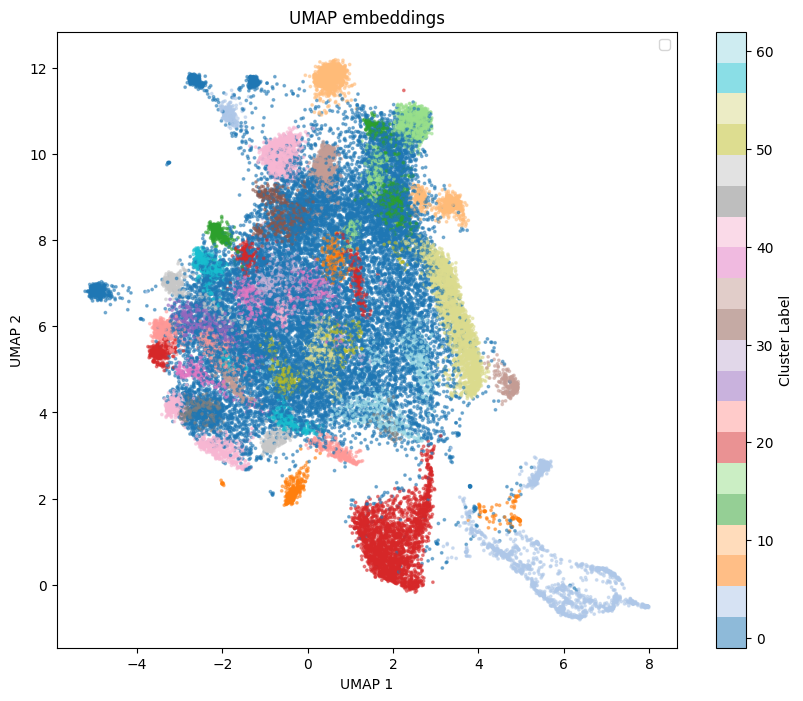

In [223]:
from hdbscan import HDBSCAN

hdbscan_clf = HDBSCAN(
    min_cluster_size=40,
    min_samples=10,
    metric="euclidean",
    cluster_selection_method="eom",
)
hdbscan_clf.fit(X_umap_10d3)
clusters = hdbscan_clf.labels_
plot_umap_clusters(X_umap_2d2, clusters, alpha=0.5, cmap='tab20', size=3)

Metric: euclidean, Min Cluster Size: 300, Min Samples: 10
Metric: euclidean, Min Cluster Size: 300, Min Samples: 15
Metric: euclidean, Min Cluster Size: 300, Min Samples: 20
Metric: euclidean, Min Cluster Size: 300, Min Samples: 25
Metric: euclidean, Min Cluster Size: 300, Min Samples: 30
Metric: euclidean, Min Cluster Size: 300, Min Samples: 35
Metric: euclidean, Min Cluster Size: 300, Min Samples: 40
Metric: euclidean, Min Cluster Size: 300, Min Samples: 45
Metric: euclidean, Min Cluster Size: 325, Min Samples: 10
Metric: euclidean, Min Cluster Size: 325, Min Samples: 15
Metric: euclidean, Min Cluster Size: 325, Min Samples: 20
Metric: euclidean, Min Cluster Size: 325, Min Samples: 25
Metric: euclidean, Min Cluster Size: 325, Min Samples: 30
Metric: euclidean, Min Cluster Size: 325, Min Samples: 35
Metric: euclidean, Min Cluster Size: 325, Min Samples: 40
Metric: euclidean, Min Cluster Size: 325, Min Samples: 45
Metric: euclidean, Min Cluster Size: 350, Min Samples: 10
Metric: euclid

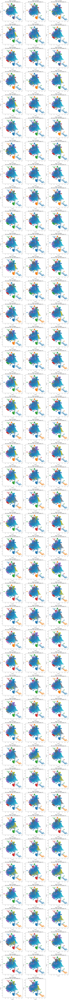

In [28]:
results = test_hdbscan_params(X_umap_20d1, X_umap_2d2)
plot_all_results(results, X_umap_2d2)

Metric: euclidean, Min Cluster Size: 300, Min Samples: 10
Metric: euclidean, Min Cluster Size: 300, Min Samples: 15
Metric: euclidean, Min Cluster Size: 300, Min Samples: 20
Metric: euclidean, Min Cluster Size: 300, Min Samples: 25
Metric: euclidean, Min Cluster Size: 300, Min Samples: 30
Metric: euclidean, Min Cluster Size: 300, Min Samples: 35
Metric: euclidean, Min Cluster Size: 300, Min Samples: 40
Metric: euclidean, Min Cluster Size: 300, Min Samples: 45
Metric: euclidean, Min Cluster Size: 310, Min Samples: 10
Metric: euclidean, Min Cluster Size: 310, Min Samples: 15
Metric: euclidean, Min Cluster Size: 310, Min Samples: 20
Metric: euclidean, Min Cluster Size: 310, Min Samples: 25
Metric: euclidean, Min Cluster Size: 310, Min Samples: 30
Metric: euclidean, Min Cluster Size: 310, Min Samples: 35
Metric: euclidean, Min Cluster Size: 310, Min Samples: 40
Metric: euclidean, Min Cluster Size: 310, Min Samples: 45
Metric: euclidean, Min Cluster Size: 320, Min Samples: 10
Metric: euclid

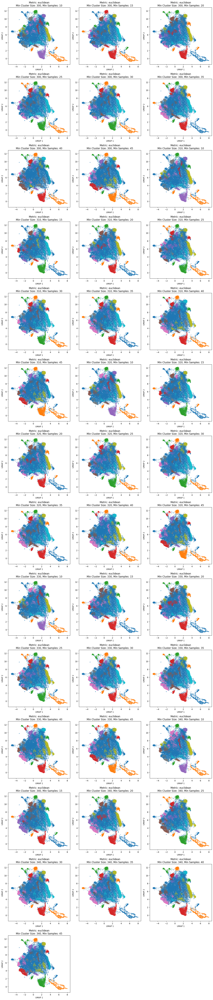

In [16]:
results3 = test_hdbscan_params(X_umap_10d3, X_umap_2d2)
plot_all_results(results3, X_umap_2d2)

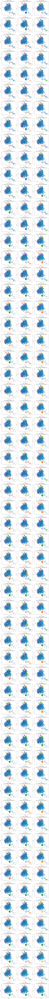

In [345]:
plot_all_results(results3, X_umap_2d2)

In [87]:
unique_speakers = sampled_train_meta['speaker_id'].unique()
sampled_speakers = np.random.choice(unique_speakers, size=10, replace=False)
print(unique_speakers)

[13177  3986 10226 12459  8728  8167 13116 12150 13313 12674 13894 11093
 11879  3803 13033 10453 10326 13009 12339 12960 13103  7122  6047 10218
 13522  5939 12119 10826  9679  7875 11938  1982 12659 13194 13422 12028
  7171  2221  2556 13506 12037  8908 10917 11988 10845  8473  3426  2904
 12499  1127  7579 11130 11252  3169 13092 12236 11341  4627]


In [40]:
uq_config = sampled_train_meta['config'].unique()
mapped_config = {c: i for i, c in enumerate(uq_config)}
config_labels = sampled_train_meta['config'].map(mapped_config).fillna(-1).astype(int).to_numpy()
print(np.unique(config_labels))

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20]


In [45]:
mapped_config

{'mls-vocoders-style_melgan': 0,
 'mls-tts-sparktts': 1,
 'mls-vocoders-full_band_melgan': 2,
 'mls-tts-cosyvoice': 3,
 'mls-vocoders-hifigan': 4,
 'mls-vocoders-bigvsan': 5,
 'mls-tts-bark': 6,
 'mls-vocoders-univnet': 7,
 'mls-tts-chattts': 8,
 'mls-vocoders-melgan': 9,
 'mls-tts-f5_tts': 10,
 'mls-vocoders-vocos': 11,
 'mls-tts-fish_speech': 12,
 'mls-tts-vits': 13,
 'mls-vocoders-multi_band_melgan': 14,
 'mls-vocoders-parallel_wavegan': 15,
 'mls-bonafide': 16,
 'mls-tts-zonos': 17,
 'mls-vocoders-bigvgan': 18,
 'mls-tts-xtts': 19,
 'mls-tts-yourtts': 20}

In [89]:
# map speakers to clusters
speakers_map = {s : i for i, s in enumerate(unique_speakers.tolist())}
print(speakers_map)

speaker_labels = sampled_train_meta['speaker_id'].map(speakers_map).fillna(-1).astype(int).to_numpy()
print(np.unique(speaker_labels))

{13177: 0, 3986: 1, 10226: 2, 12459: 3, 8728: 4, 8167: 5, 13116: 6, 12150: 7, 13313: 8, 12674: 9, 13894: 10, 11093: 11, 11879: 12, 3803: 13, 13033: 14, 10453: 15, 10326: 16, 13009: 17, 12339: 18, 12960: 19, 13103: 20, 7122: 21, 6047: 22, 10218: 23, 13522: 24, 5939: 25, 12119: 26, 10826: 27, 9679: 28, 7875: 29, 11938: 30, 1982: 31, 12659: 32, 13194: 33, 13422: 34, 12028: 35, 7171: 36, 2221: 37, 2556: 38, 13506: 39, 12037: 40, 8908: 41, 10917: 42, 11988: 43, 10845: 44, 8473: 45, 3426: 46, 2904: 47, 12499: 48, 1127: 49, 7579: 50, 11130: 51, 11252: 52, 3169: 53, 13092: 54, 12236: 55, 11341: 56, 4627: 57}
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57]


0
(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57]), array([639, 611, 678, 781, 678, 660, 739, 682, 622, 667, 720, 766, 633,
       669, 706, 659, 642, 701, 657, 685, 677, 631, 670, 654, 624, 651,
       723, 807, 698, 750, 666, 671, 666, 646, 677, 651, 672, 653, 730,
       720, 667, 640, 706, 661, 724, 692, 683, 751, 587, 590, 680, 591,
       765, 805, 669, 616, 670, 705]))


/var/folders/1d/mv_j9c7964b105nch0pj7kgh0000gn/T/ipykernel_87464/318230882.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


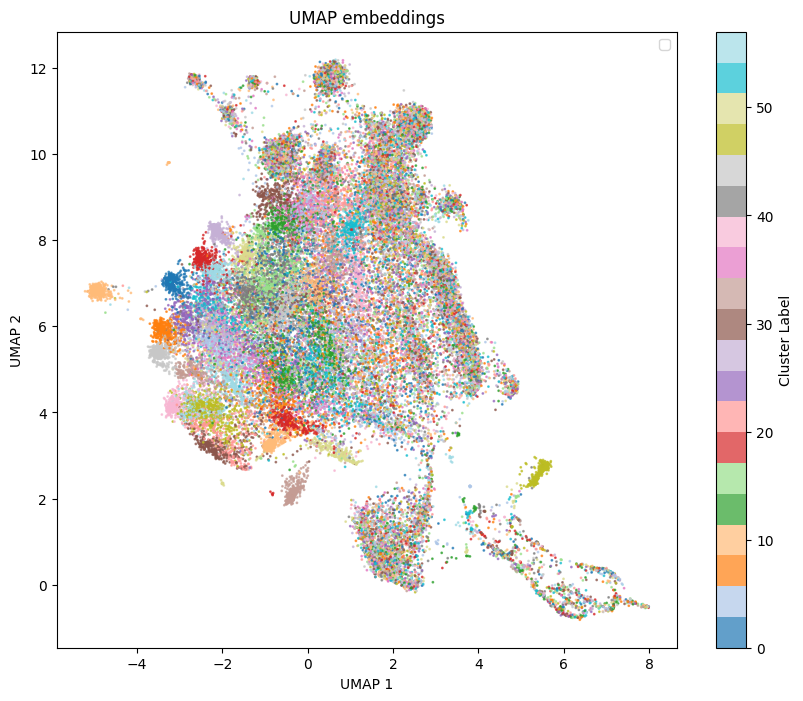

In [346]:
plot_umap_clusters(X_umap_2d2, speaker_labels, alpha=0.7)

In [54]:
mask = sampled_train_meta['config'] == 'mls-vocoders-full_band_melgan'

In [283]:
uq_speakers = sampled_train_meta['speaker_id'].unique()
mapped_speakers = {s: i for i, s in enumerate(uq_speakers)}
speaker_labels = sampled_train_meta['speaker_id'].map(mapped_speakers).fillna(-1).astype(int).to_numpy()
print(np.unique(speaker_labels))

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57]


Text(0, 0.5, 'UMAP 2')

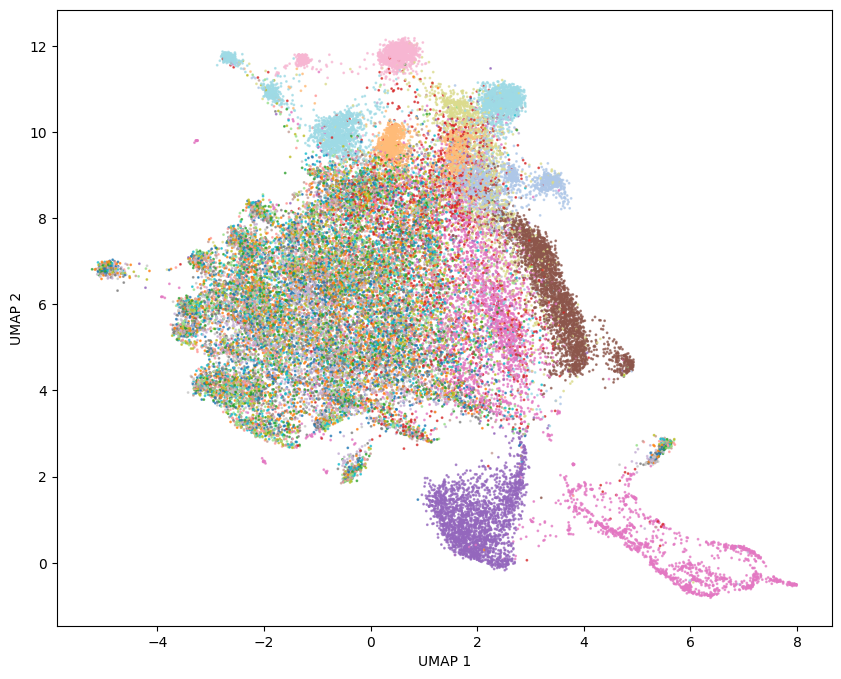

In [347]:
plt.figure(figsize=(10, 8))
plt.scatter(X_umap_2d2[:, 0], X_umap_2d2[:, 1], s=1, alpha=0.7, c=config_labels, cmap='tab20')
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")

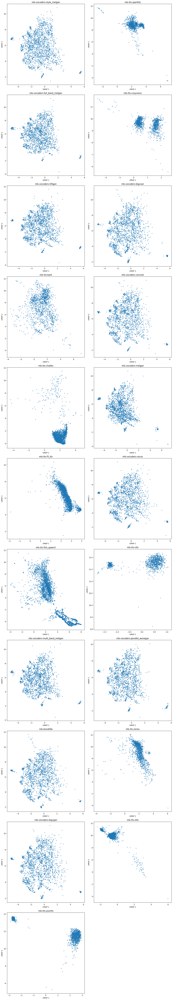

In [282]:

plt.figure(figsize=(14, 80))
for i, (cfg, _) in enumerate(mapped_config.items()):
    plt.subplot(11, 2, i+1)
    mask = sampled_train_meta['config'] == cfg
    plt.scatter(X_umap_2d2[mask, 0], X_umap_2d2[mask, 1], s=7, alpha=0.7)
    plt.xlabel("UMAP 1")
    plt.ylabel("UMAP 2")
    plt.title(f"{cfg}")
plt.tight_layout()

270
(array([-1,  0,  1,  2,  3,  4]), array([  270,  2369,  1134, 34919,   364,   378]))


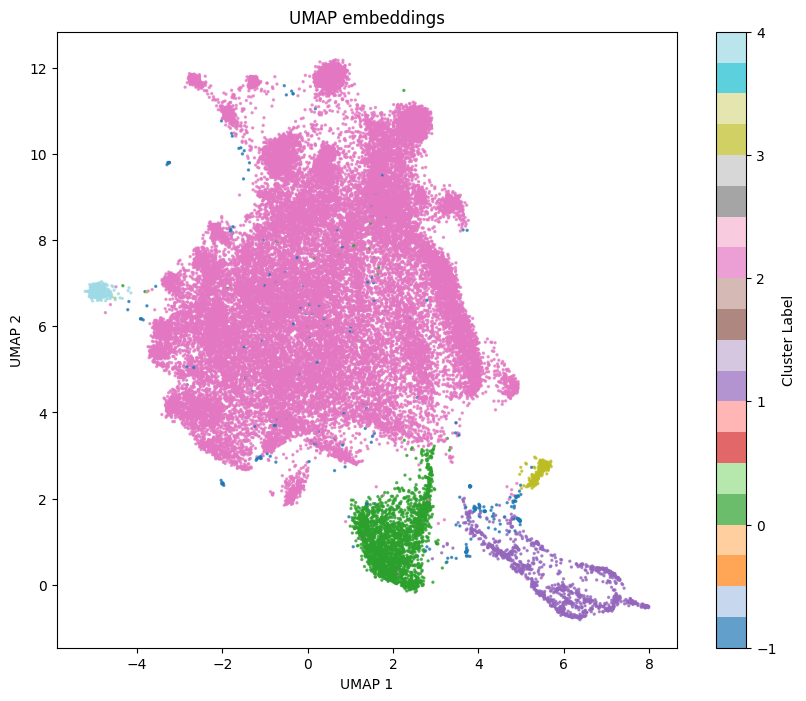

In [354]:
hdbscan = HDBSCAN(
    min_cluster_size=250,
    min_samples=45,
    metric="euclidean",
    cluster_selection_method="eom",
    prediction_data=True,
)
hdbscan.fit(X_umap_10d)
clusters = hdbscan.labels_
plot_umap_clusters(X_umap_2d, clusters)

19034
(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
       33, 34, 35, 36, 37, 38, 39, 40, 41]), array([19034,   380,   364,   223,  1097,   369,   937,   343,   247,
         297,   205,   437,   296,   525,  2278,   240,   371,   434,
         545,   400,   294,   257,   305,   319,   437,   504,   992,
         204,   403,   746,   242,   481,   250,  1107,   502,   391,
         402,   380,   227,   628,   466,   586,   289]))


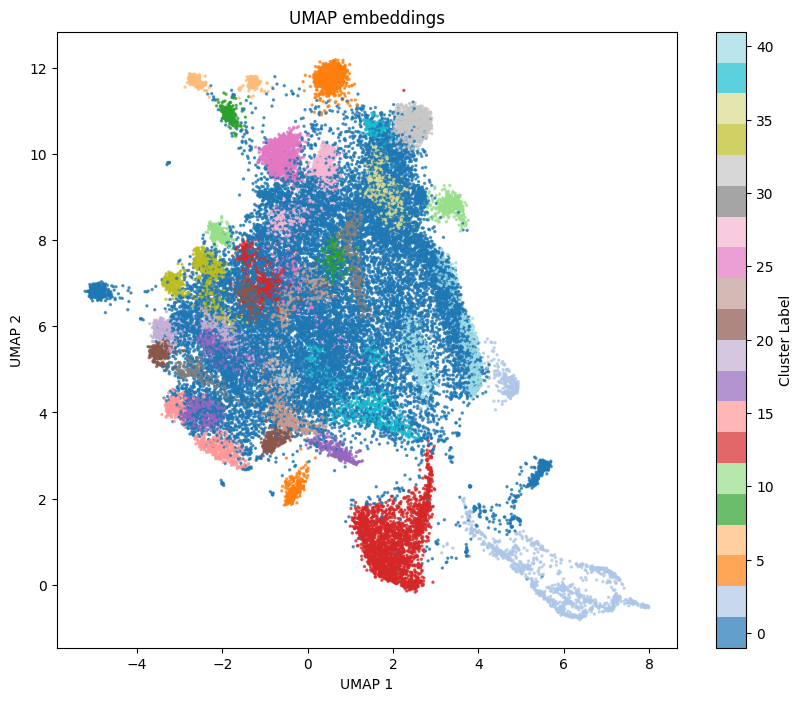

In [277]:
hdbscan = HDBSCAN(
    min_cluster_size=200,
    min_samples=20,
    metric="euclidean",
    cluster_selection_method="leaf",
    prediction_data=True,
)
hdbscan.fit(X_umap_10d)



clusters = hdbscan.labels_
print(np.sum(clusters == -1))
print(np.unique(clusters, return_counts=True))
plt.figure(figsize=(10, 8))
plt.scatter(X_umap_2d[:, 0], X_umap_2d[:, 1], s=2, alpha=0.7, c=clusters, cmap='tab20')
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("UMAP embeddings")
plt.colorbar(label='Cluster Label')
plt.show()


17703
(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22]), array([17703,  2376,   745,  1220,   928,   943,   433,  1595,   987,
         534,  1206,   983,  2783,   422,   724,   469,   511,   956,
        1055,   705,   409,   434,   810,   503]))


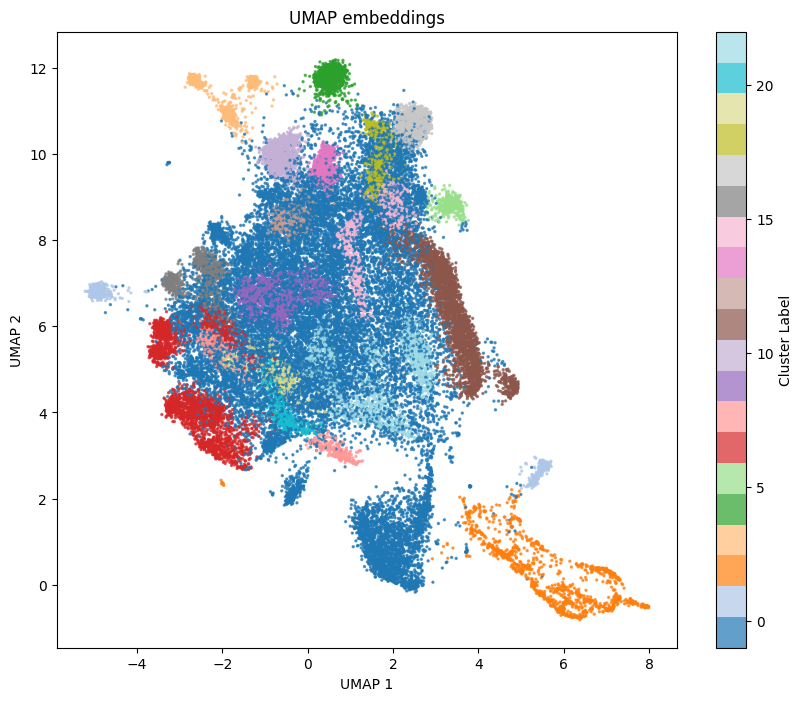

In [322]:
hdbscan = HDBSCAN(
    min_cluster_size=400,
    min_samples=30,
    metric="euclidean",
    cluster_selection_method="leaf",
    prediction_data=True,
)
hdbscan.fit(X_umap_10d)



clusters = hdbscan.labels_
print(np.sum(clusters == -1))
print(np.unique(clusters, return_counts=True))
plt.figure(figsize=(10, 8))
plt.scatter(X_umap_2d[:, 0], X_umap_2d[:, 1], s=2, alpha=0.7, c=clusters, cmap='tab20')
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("UMAP embeddings")
plt.colorbar(label='Cluster Label')
plt.show()

In [112]:
from src.preprocessing.feature_loader import FeatureLoader

feature_loader = FeatureLoader(file_name="feature_extracted")
train_meta = feature_loader.load_split_file(split_name="train")
print(train_meta.shape)

(788680, 7)


In [114]:
feature_loader2 = FeatureLoader(file_name="feature_extracted_audio_ids")
train_meta2 = feature_loader2.load_split_file(split_name="train")
print(train_meta2.shape)
print(train_meta2.head())

(788680, 8)
     duration  starting_point        config split  record_id  speaker_id  \
209       4.0             0.0  mls-bonafide   dev         30       10218   
210       4.0             2.0  mls-bonafide   dev         30       10218   
211       4.0             4.0  mls-bonafide   dev         30       10218   
212       4.0             6.0  mls-bonafide   dev         30       10218   
213       4.0             8.0  mls-bonafide   dev         30       10218   

       target  unique_audio_id  
209  bonafide                0  
210  bonafide                0  
211  bonafide                0  
212  bonafide                0  
213  bonafide                0  
